# Task 1
# Question 1

In [2]:
import torch
import numpy as np

# Set seed for reproducibility
np.random.seed(45)

# Generate dataset
num_samples = 40
x1 = np.random.uniform(-1, 1, num_samples)
f_x = 3 * x1 + 4
eps = np.random.randn(num_samples)
y = f_x + eps

# numpy arrays to torch tensors
x1_tensor = torch.tensor(x1, dtype=torch.float32, requires_grad=False)
y_tensor = torch.tensor(y, dtype=torch.float32, requires_grad=False)

# t0=int(input("Enter value of theta0: "))
# t1=int(input("Enter value of theta1: "))

t0 =0
t1 =0

theta0 = torch.tensor(t0, dtype=torch.float32, requires_grad=True)
theta1 = torch.tensor(t1, dtype=torch.float32, requires_grad=True)


def linear_model(x, theta0, theta1):
    return theta1 * x + theta0

# loss function (Mean Squared Error)
def compute_loss(predictions, targets):
    return torch.mean((predictions - targets) ** 2)

# forward pass
predictions = linear_model(x1_tensor, theta0, theta1)
loss = compute_loss(predictions, y_tensor)

# Compute gradients
loss.backward()


print("Gradient of loss w.r.t theta0:", theta0.grad.item())
print("Gradient of loss w.r.t theta1:", theta1.grad.item())


Gradient of loss w.r.t theta0: -7.447054386138916
Gradient of loss w.r.t theta1: -1.0253016948699951


# Question 2


In [3]:

#  lists to store gradients
gradients_theta_0 = []
gradients_theta_1 = []


for i in range(num_samples):
    # Extract the i-th data point
    x1_i = x1_tensor[i]
    y_i = y_tensor[i]

   
    theta_0 = torch.tensor(t0, dtype=torch.float32, requires_grad=True)
    theta_1 = torch.tensor(t1, dtype=torch.float32, requires_grad=True)

    #  prediction
    y_pred_i = theta_1 * x1_i + theta_0

    # (MSE)
    loss_i = (y_pred_i - y_i) ** 2

    # Compute gradients
    loss_i.backward()

    # Store gradients
    gradients_theta_0.append(theta_0.grad.item())
    gradients_theta_1.append(theta_1.grad.item())

# Compute average gradients
avg_gradient_theta_0 = np.mean(gradients_theta_0)
avg_gradient_theta_1 = np.mean(gradients_theta_1)

# Print the results
print(f"Average Stochastic Gradient w.r.t. θ0: {avg_gradient_theta_0}")
print(f"Average Stochastic Gradient w.r.t. θ1: {avg_gradient_theta_1}")

# The true gradient should be printed from the previous step
print(f"True Gradient w.r.t. θ0: ", theta0.grad.item())
print(f"True Gradient w.r.t. θ1: ", theta1.grad.item())


Average Stochastic Gradient w.r.t. θ0: -7.4470539569854735
Average Stochastic Gradient w.r.t. θ1: -1.0253017988055944
True Gradient w.r.t. θ0:  -7.447054386138916
True Gradient w.r.t. θ1:  -1.0253016948699951


# Question 3

## With LR = 0.0001

1.When LR is 0.0001, we see that all the methods nearly took the same average number of iterations.

2.Average Iterations: SGD > MBD > FBD

3.Average Epochs: FGD >> MBD >> SGD

4.Also for epochs, FBD = 4 * MBD = 40 * SGD (Batch-size for MBD was 10, and the sample size was 40)

5.For very low learning rate ad 0.0001, the number of epochs is FBD because it has iteration per epoch but other methods have multiple iterations per epoch.

Optimal theta0: 3.9507062435150146

Optimal theta1: 2.682468891143799

Optimal loss: 0.5957542061805725

Average Full-batch GD converged in 41723.00 iterations and 41723.00 epochs

Average Mini-batch GD converged in 41771.60 iterations and 10442.90 epochs

Average SGD converged in 43132.00 iterations and 1078.30 epochs


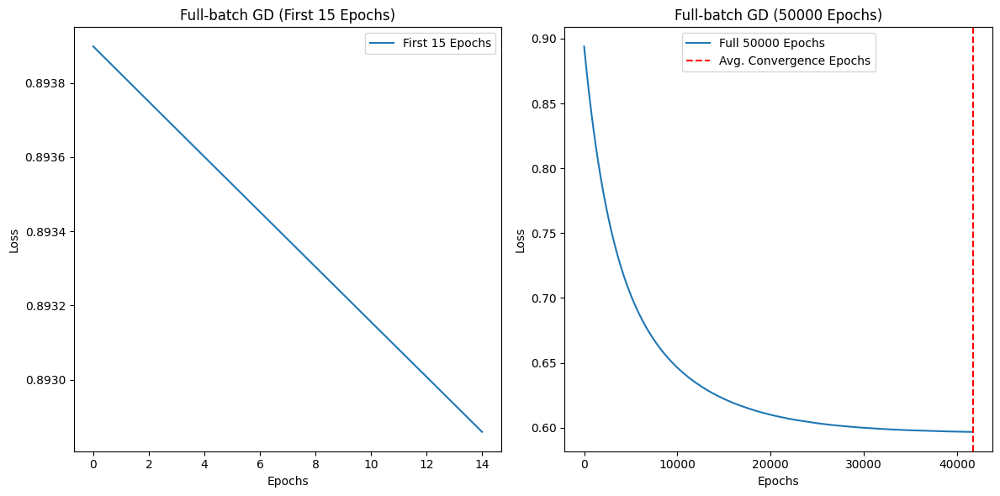

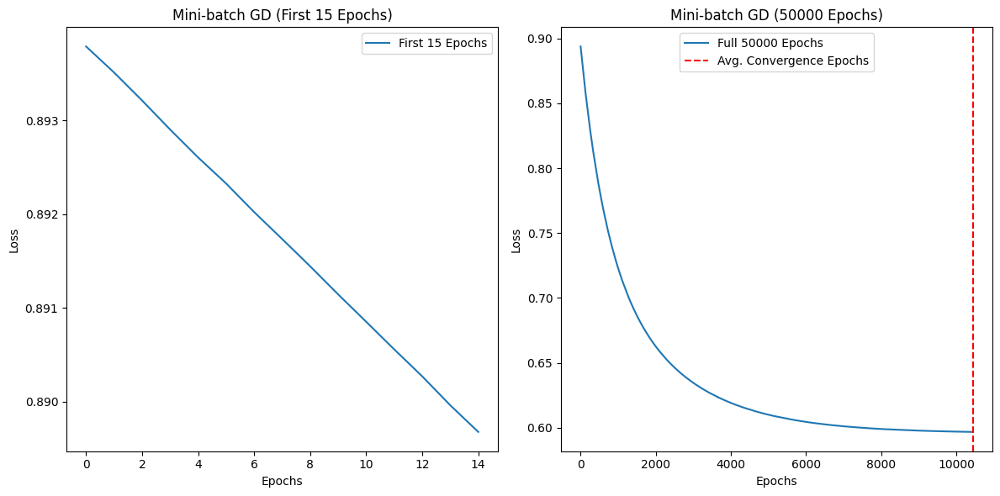

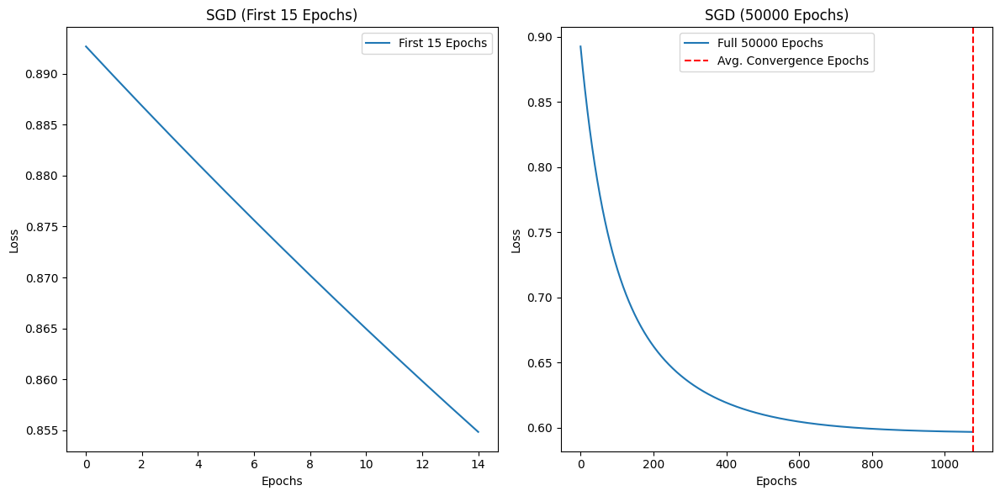

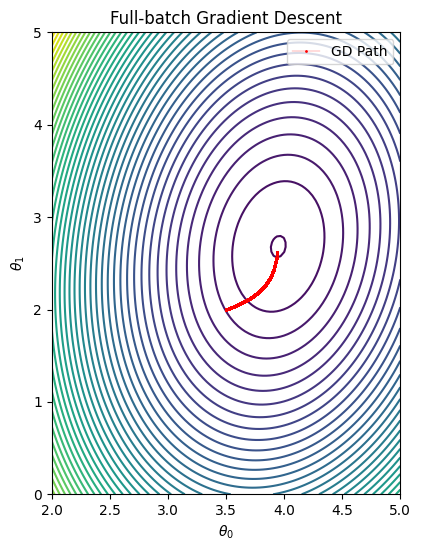

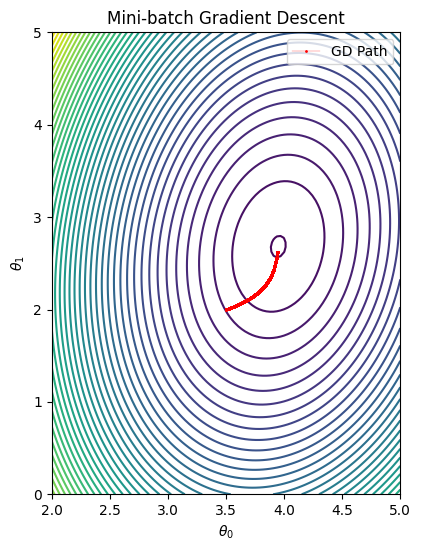

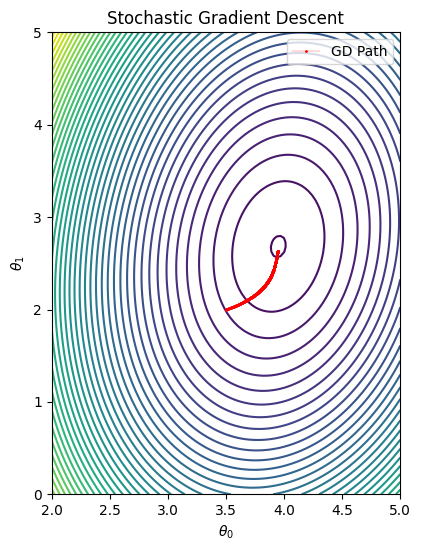

In [ ]:
import matplotlib.pyplot as plt
import torch
import numpy as np

# Gradient Descent Update Step 
def update_params(theta0, theta1, grads, lr):
    theta0.data = theta0 - lr * grads[0] 
    theta1.data = theta1 - lr * grads[1]  
    return theta0, theta1

# Plotting loss over epochs for each method
def plot_loss(losses, title, avg_epochs, max_epochs, filename):
    plt.figure(figsize=(12, 6))

    # Loss for the first 15 epochs
    plt.subplot(1, 2, 1)
    plt.plot(losses[:15], label='First 15 Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'{title} (First 15 Epochs)')
    plt.legend()

    # Loss for the full 50000 epochs
    plt.subplot(1, 2, 2)
    plt.plot(losses, label='Full Epochs')
    plt.axvline(x=avg_epochs, color='r', linestyle='--', label='Avg. Convergence Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'{title} (Full Epochs)')
    plt.legend()

    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

# Helper function to calculate the optimal loss (based on the closed-form solution or an approximation)
def calculate_optimal_loss(x, y):
    optimal_theta1 = (torch.mean(x * y) - torch.mean(x) * torch.mean(y)) / (torch.mean(x ** 2) - torch.mean(x) ** 2)
    optimal_theta0 = torch.mean(y) - optimal_theta1 * torch.mean(x)
    print(f"Optimal theta0: {optimal_theta0}")
    print(f"Optimal theta1: {optimal_theta1}")

    preds = linear_model(x, optimal_theta0, optimal_theta1)
    optimal_loss = compute_loss(preds, y)
    return optimal_loss.item()

# Full-batch Gradient Descent
def full_batch_gd(x, y, theta0, theta1, lr=0.0001, epochs=50000, epsilon=0.001, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    for epoch in range(epochs):
        preds = linear_model(x, theta0, theta1)
        loss = compute_loss(preds, y)
        losses.append(loss.item())

        loss.backward()
        grads = [theta0.grad, theta1.grad]
        theta0, theta1 = update_params(theta0, theta1, grads, lr)
        theta0.grad.zero_()
        theta1.grad.zero_()

        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())

        iterations += 1
        if abs(loss.item() - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1 , theta0_path, theta1_path

# Mini-batch Gradient Descent
def mini_batch_gd(x, y, theta0, theta1, lr=0.0001, epochs=50000, batch_size=10, epsilon=0.001, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    dataset = torch.utils.data.TensorDataset(x, y)
    loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

    for epoch in range(epochs):
        epoch_loss = 0
        for batch_x, batch_y in loader:
            preds = linear_model(batch_x, theta0, theta1)
            loss = compute_loss(preds, batch_y)
            epoch_loss += loss.item()

            loss.backward()
            grads = [theta0.grad, theta1.grad]
            theta0, theta1 = update_params(theta0, theta1, grads, lr)
            theta0.grad.zero_()
            theta1.grad.zero_()

            # theta0_path.append(theta0.item())
            # theta1_path.append(theta1.item())

            iterations += 1

        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())
        avg_loss = epoch_loss / len(loader)
        losses.append(avg_loss)
        if abs(avg_loss - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1 , theta0_path, theta1_path

# Stochastic Gradient Descent (SGD)
def sgd(x, y, theta0, theta1, lr=0.0001, epochs=50000, epsilon=0.001, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    dataset = torch.utils.data.TensorDataset(x, y)
    loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=True)

    for epoch in range(epochs):
        epoch_loss = 0
        for point_x, point_y in loader:
            preds = linear_model(point_x, theta0, theta1)
            loss = compute_loss(preds, point_y)
            epoch_loss += loss.item()

            loss.backward()
            grads = [theta0.grad, theta1.grad]
            theta0, theta1 = update_params(theta0, theta1, grads, lr)
            theta0.grad.zero_()
            theta1.grad.zero_()
            iterations += 1

        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())



        avg_loss = epoch_loss / len(loader)
        losses.append(avg_loss)
        if abs(avg_loss - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1, theta0_path, theta1_path

# Function to create contour plot
def plot_contour(x, y, theta0_path, theta1_path, title):
    # Define theta0 and theta1 grid
    theta0_vals = np.linspace(2, 5, 100)
    theta1_vals = np.linspace(0, 5, 100)
    theta0_grid, theta1_grid = np.meshgrid(theta0_vals, theta1_vals)

    # Compute loss for each combination of theta0 and theta1
    loss_grid = np.zeros_like(theta0_grid)
    for i in range(theta0_grid.shape[0]):
        for j in range(theta0_grid.shape[1]):
            preds = theta1_grid[i, j] * x + theta0_grid[i, j]
            loss_grid[i, j] = np.mean((y - preds) ** 2)

    # Plot contour
    plt.figure(figsize=(4.5, 6))
    plt.contour(theta0_grid, theta1_grid, loss_grid, levels=50, cmap='viridis')
    plt.plot(theta0_path, theta1_path, marker='o', markersize=1,linewidth=0.2, color='red', label='GD Path')
    plt.title(title)
    plt.xlabel(r'$\theta_0$')
    plt.ylabel(r'$\theta_1$')
    plt.legend()
    plt.show()

# Initialization and parameters
theta0_init = torch.tensor([3.5], dtype=torch.float32, requires_grad=True)
theta1_init = torch.tensor([2], dtype=torch.float32, requires_grad=True)

# Compute the optimal loss
optimal_loss = calculate_optimal_loss(x1_tensor, y_tensor)
print(f"Optimal loss: {optimal_loss}")

# Run each method multiple times to calculate average iterations and epochs to convergence
num_runs = 10
full_batch_iterations = []
mini_batch_iterations = []
sgd_iterations_list = []
full_batch_epochs = []
mini_batch_epochs = []
sgd_epochs_list = []

for _ in range(num_runs):
    theta0_full, theta1_full, full_losses, full_iterations, full_epochs,full_theta0_path, full_theta1_path = full_batch_gd(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )
    theta0_mini, theta1_mini, mini_losses, mini_iterations, mini_epochs , mini_theta0_path, mini_theta1_path= mini_batch_gd(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )
    theta0_sgd, theta1_sgd, sgd_losses, sgd_iterations, sgd_epochs , sgd_theta0_path, sgd_theta1_path = sgd(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )

    full_batch_iterations.append(full_iterations)
    mini_batch_iterations.append(mini_iterations)
    sgd_iterations_list.append(sgd_iterations)

    full_batch_epochs.append(full_epochs)
    mini_batch_epochs.append(mini_epochs)
    sgd_epochs_list.append(sgd_epochs)

# Calculate average number of iterations and epochs
avg_full_batch_iterations = np.mean(full_batch_iterations)
avg_mini_batch_iterations = np.mean(mini_batch_iterations)
avg_sgd_iterations = np.mean(sgd_iterations_list)

avg_full_batch_epochs = np.mean(full_batch_epochs)
avg_mini_batch_epochs = np.mean(mini_batch_epochs)
avg_sgd_epochs = np.mean(sgd_epochs_list)

# Print the average number of iterations and epochs for each method
print(f"Average Full-batch GD converged in {avg_full_batch_iterations:.2f} iterations and {avg_full_batch_epochs:.2f} epochs")
print(f"Average Mini-batch GD converged in {avg_mini_batch_iterations:.2f} iterations and {avg_mini_batch_epochs:.2f} epochs")
print(f"Average SGD converged in {avg_sgd_iterations:.2f} iterations and {avg_sgd_epochs:.2f} epochs")

# Plotting the losses for comparison (visualizing for 15 and 50000 epochs)
plot_loss(full_losses, "Full-batch GD", avg_full_batch_epochs, 50000, 'full_batch_gd.png')
plot_loss(mini_losses, "Mini-batch GD", avg_mini_batch_epochs, 50000, 'mini_batch_gd.png')
plot_loss(sgd_losses, "SGD", avg_sgd_epochs, 50000, 'sgd.png')

# Plot the contour plots for each method
plot_contour(x1, y, full_theta0_path, full_theta1_path, "Full-batch Gradient Descent")
plot_contour(x1, y, mini_theta0_path, mini_theta1_path, "Mini-batch Gradient Descent")
plot_contour(x1, y, sgd_theta0_path, sgd_theta1_path, "Stochastic Gradient Descent")

## With LR =0.01

Thw realations seen when we increase the LR, don't hold because with increase step size we need to be more accurate with our direction which means we need to avoid noisy movements but that is what actually stochastic gradient does. From the plot of first 15 epochs we see that SGD starts better but due to its large step size it will be case of luck to reach the optimal range, because its step size is large and it will just hover around the solution.

Optimal theta0: 3.9507062435150146
Optimal theta1: 2.682468891143799
Optimal loss: 0.5957542061805725
Average Full-batch GD converged in 417.00 iterations and 417.00 epochs
Average Mini-batch GD converged in 487.60 iterations and 121.90 epochs
Average SGD converged in 120000.00 iterations and 3000.00 epochs


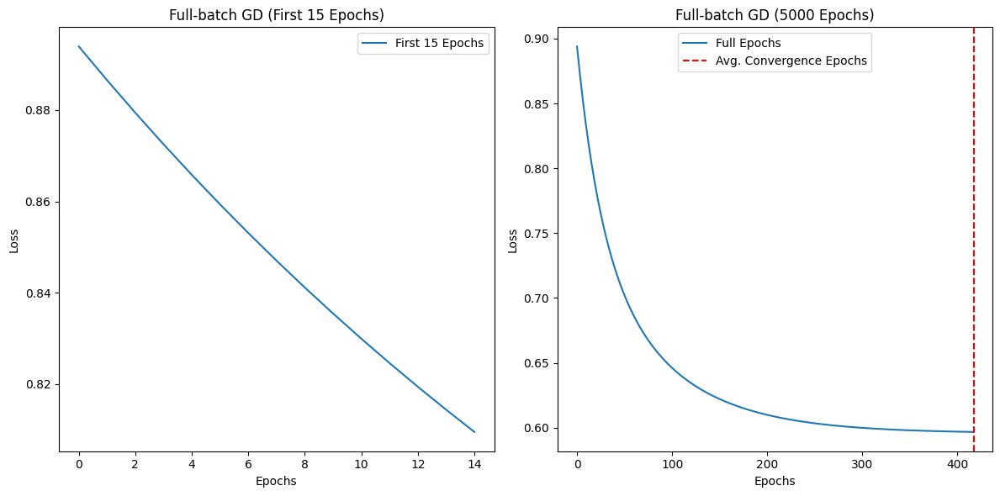

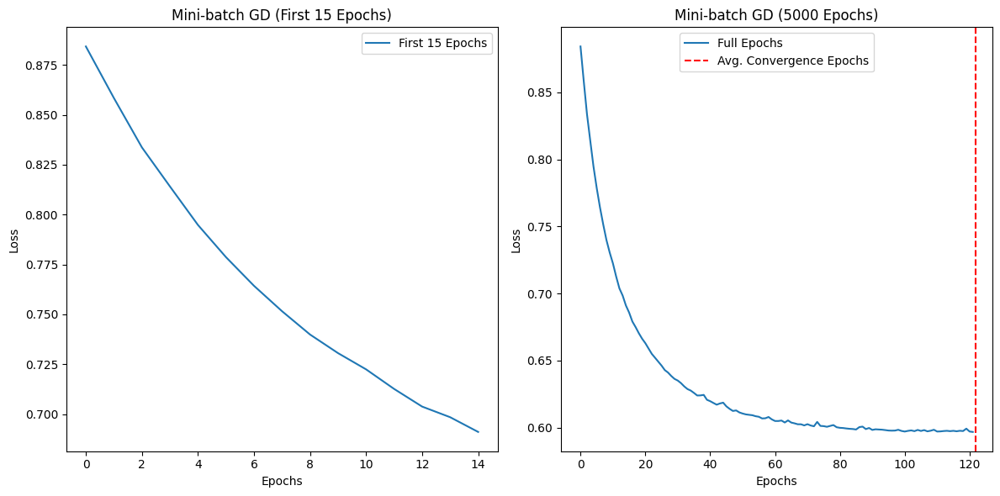

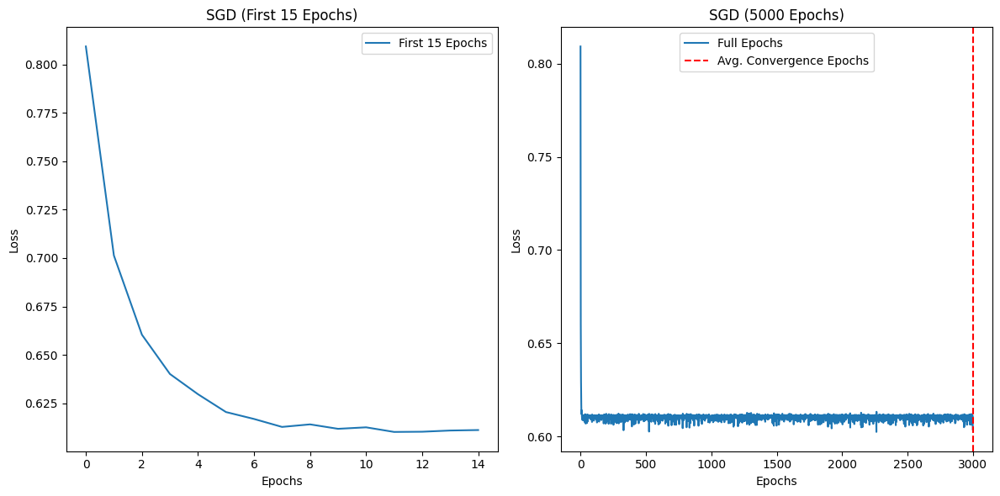

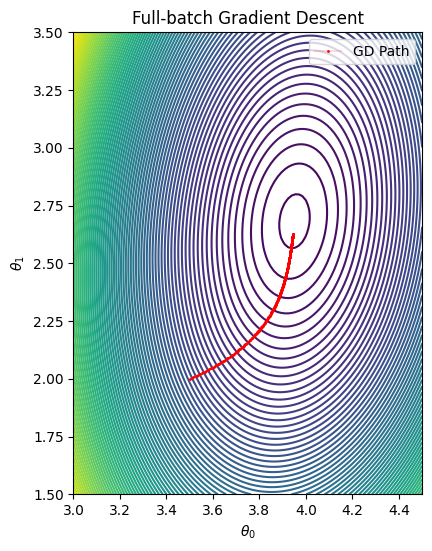

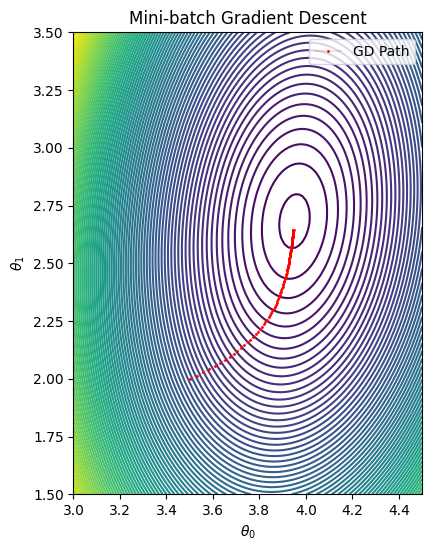

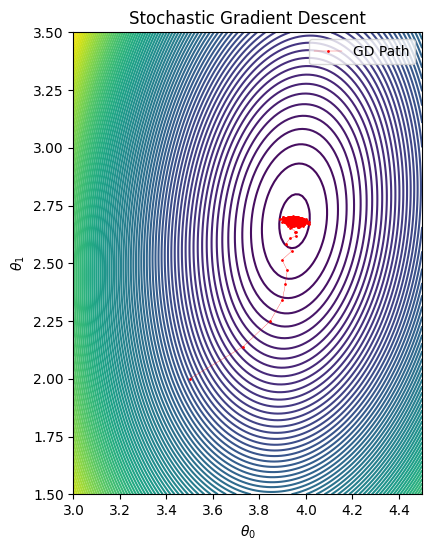

In [3]:
import matplotlib.pyplot as plt
import torch
import numpy as np

# Gradient Descent Update Step (with out-of-place operations)
def update_params(theta0, theta1, grads, lr):
    theta0.data = theta0 - lr * grads[0]  # out-of-place operation
    theta1.data = theta1 - lr * grads[1]  # out-of-place operation
    return theta0, theta1

# Plotting loss over epochs for each method
def plot_loss(losses, title, avg_epochs, max_epochs, filename):
    plt.figure(figsize=(12, 6))

    # Loss for the first 15 epochs
    plt.subplot(1, 2, 1)
    plt.plot(losses[:15], label='First 15 Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'{title} (First 15 Epochs)')
    plt.legend()

    # Loss for the full 5000 epochs
    plt.subplot(1, 2, 2)
    plt.plot(losses, label='Full Epochs')
    plt.axvline(x=avg_epochs, color='r', linestyle='--', label='Avg. Convergence Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'{title} (5000 Epochs)')
    plt.legend()

    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

# Helper function to calculate the optimal loss (based on the closed-form solution or an approximation)
def calculate_optimal_loss(x, y):
    optimal_theta1 = (torch.mean(x * y) - torch.mean(x) * torch.mean(y)) / (torch.mean(x ** 2) - torch.mean(x) ** 2)
    optimal_theta0 = torch.mean(y) - optimal_theta1 * torch.mean(x)
    print(f"Optimal theta0: {optimal_theta0}")
    print(f"Optimal theta1: {optimal_theta1}")

    preds = linear_model(x, optimal_theta0, optimal_theta1)
    optimal_loss = compute_loss(preds, y)
    return optimal_loss.item()

# Full-batch Gradient Descent
def full_batch_gd(x, y, theta0, theta1, lr=0.01, epochs=5000, epsilon=0.001, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    for epoch in range(epochs):
        preds = linear_model(x, theta0, theta1)
        loss = compute_loss(preds, y)
        losses.append(loss.item())

        loss.backward()
        grads = [theta0.grad, theta1.grad]
        theta0, theta1 = update_params(theta0, theta1, grads, lr)
        theta0.grad.zero_()
        theta1.grad.zero_()

        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())

        iterations += 1
        if abs(loss.item() - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1 , theta0_path, theta1_path

# Mini-batch Gradient Descent
def mini_batch_gd(x, y, theta0, theta1, lr=0.01, epochs=5000, batch_size=10, epsilon=0.001, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    dataset = torch.utils.data.TensorDataset(x, y)
    loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

    for epoch in range(epochs):
        epoch_loss = 0
        for batch_x, batch_y in loader:
            preds = linear_model(batch_x, theta0, theta1)
            loss = compute_loss(preds, batch_y)
            epoch_loss += loss.item()

            loss.backward()
            grads = [theta0.grad, theta1.grad]
            theta0, theta1 = update_params(theta0, theta1, grads, lr)
            theta0.grad.zero_()
            theta1.grad.zero_()

            # theta0_path.append(theta0.item())
            # theta1_path.append(theta1.item())

            iterations += 1

        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())
        avg_loss = epoch_loss / len(loader)
        losses.append(avg_loss)
        if abs(avg_loss - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1 , theta0_path, theta1_path

# Stochastic Gradient Descent (SGD)
def sgd(x, y, theta0, theta1, lr=0.01, epochs=3000, epsilon=0.001, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    dataset = torch.utils.data.TensorDataset(x, y)
    loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=True)

    for epoch in range(epochs):
        epoch_loss = 0
        for point_x, point_y in loader:
            preds = linear_model(point_x, theta0, theta1)
            loss = compute_loss(preds, point_y)
            epoch_loss += loss.item()

            loss.backward()
            grads = [theta0.grad, theta1.grad]
            theta0, theta1 = update_params(theta0, theta1, grads, lr)
            theta0.grad.zero_()
            theta1.grad.zero_()
            iterations += 1

        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())



        avg_loss = epoch_loss / len(loader)
        losses.append(avg_loss)
        if abs(avg_loss - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1, theta0_path, theta1_path

# Function to create contour plot
def plot_contour(x, y, theta0_path, theta1_path, title):
    # Define theta0 and theta1 grid
    theta0_vals = np.linspace(3, 4.5, 100)
    theta1_vals = np.linspace(1.5, 3.5, 100)
    theta0_grid, theta1_grid = np.meshgrid(theta0_vals, theta1_vals)

    # Compute loss for each combination of theta0 and theta1
    loss_grid = np.zeros_like(theta0_grid)
    for i in range(theta0_grid.shape[0]):
        for j in range(theta0_grid.shape[1]):
            preds = theta1_grid[i, j] * x + theta0_grid[i, j]
            loss_grid[i, j] = np.mean((y - preds) ** 2)

    # Plot contour
    plt.figure(figsize=(4.5, 6))
    plt.contour(theta0_grid, theta1_grid, loss_grid, levels=100, cmap='viridis')
    plt.plot(theta0_path, theta1_path, marker='o', markersize=1,linewidth=0.2, color='red', label='GD Path')
    plt.title(title)
    plt.xlabel(r'$\theta_0$')
    plt.ylabel(r'$\theta_1$')
    plt.legend()
    plt.show()

# Initialization and parameters
theta0_init = torch.tensor([3.5], dtype=torch.float32, requires_grad=True)
theta1_init = torch.tensor([2], dtype=torch.float32, requires_grad=True)

# Compute the optimal loss
optimal_loss = calculate_optimal_loss(x1_tensor, y_tensor)
print(f"Optimal loss: {optimal_loss}")

# Run each method multiple times to calculate average iterations and epochs to convergence
num_runs = 10
full_batch_iterations = []
mini_batch_iterations = []
sgd_iterations_list = []
full_batch_epochs = []
mini_batch_epochs = []
sgd_epochs_list = []

for _ in range(num_runs):
    theta0_full, theta1_full, full_losses, full_iterations, full_epochs,full_theta0_path, full_theta1_path = full_batch_gd(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )
    theta0_mini, theta1_mini, mini_losses, mini_iterations, mini_epochs , mini_theta0_path, mini_theta1_path= mini_batch_gd(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )
    theta0_sgd, theta1_sgd, sgd_losses, sgd_iterations, sgd_epochs , sgd_theta0_path, sgd_theta1_path = sgd(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )

    full_batch_iterations.append(full_iterations)
    mini_batch_iterations.append(mini_iterations)
    sgd_iterations_list.append(sgd_iterations)

    full_batch_epochs.append(full_epochs)
    mini_batch_epochs.append(mini_epochs)
    sgd_epochs_list.append(sgd_epochs)

# Calculate average number of iterations and epochs
avg_full_batch_iterations = np.mean(full_batch_iterations)
avg_mini_batch_iterations = np.mean(mini_batch_iterations)
avg_sgd_iterations = np.mean(sgd_iterations_list)

avg_full_batch_epochs = np.mean(full_batch_epochs)
avg_mini_batch_epochs = np.mean(mini_batch_epochs)
avg_sgd_epochs = np.mean(sgd_epochs_list)

# Print the average number of iterations and epochs for each method
print(f"Average Full-batch GD converged in {avg_full_batch_iterations:.2f} iterations and {avg_full_batch_epochs:.2f} epochs")
print(f"Average Mini-batch GD converged in {avg_mini_batch_iterations:.2f} iterations and {avg_mini_batch_epochs:.2f} epochs")
print(f"Average SGD converged in {avg_sgd_iterations:.2f} iterations and {avg_sgd_epochs:.2f} epochs")

# Plotting the losses for comparison (visualizing for 15 and 5000 epochs)
plot_loss(full_losses, "Full-batch GD", avg_full_batch_epochs, 5000, 'full_batch_gd.png')
plot_loss(mini_losses, "Mini-batch GD", avg_mini_batch_epochs, 5000, 'mini_batch_gd.png')
plot_loss(sgd_losses, "SGD", avg_sgd_epochs, 3000, 'sgd.png')

# Plot the contour plots for each method
plot_contour(x1, y, full_theta0_path, full_theta1_path, "Full-batch Gradient Descent")
plot_contour(x1, y, mini_theta0_path, mini_theta1_path, "Mini-batch Gradient Descent")
plot_contour(x1, y, sgd_theta0_path, sgd_theta1_path, "Stochastic Gradient Descent")

# Question 4

## With LR = 0.001

With LR as low as 0.001 in gradient descent with momentum, it became very computational heavy leading to the code running for more than a hour and still no plots. 

In [4]:

# Gradient Descent Update Step (with momentum)
def update_params_momentum(theta0, theta1, grads, lr, momentum, prev_change_x):
    change_x = lr * grads[0] + momentum * prev_change_x[0]
    theta0.data -= change_x  # out-of-place operation

    change_y = lr * grads[1] + momentum * prev_change_x[1]
    theta1.data -= change_y  # out-of-place operation

    return theta0, theta1, (change_x, change_y)

# Plotting loss over epochs for each method
def plot_loss(losses, title, avg_epochs, max_epochs, filename):
    plt.figure(figsize=(12, 6))

    # Loss for the first 15 epochs
    plt.subplot(1, 2, 1)
    plt.plot(losses[:15], label='First 15 Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'{title} (First 15 Epochs)')
    plt.legend()

    # Loss for the full 50000 epochs
    plt.subplot(1, 2, 2)
    plt.plot(losses, label='Full 50000 Epochs')
    plt.axvline(x=avg_epochs, color='r', linestyle='--', label='Avg. Convergence Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'{title} (50000 Epochs)')
    plt.legend()

    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

# Helper function to calculate the optimal loss (based on the closed-form solution or an approximation)
def calculate_optimal_loss(x, y):
    optimal_theta1 = (torch.mean(x * y) - torch.mean(x) * torch.mean(y)) / (torch.mean(x ** 2) - torch.mean(x) ** 2)
    optimal_theta0 = torch.mean(y) - optimal_theta1 * torch.mean(x)
    print(f"Optimal theta0: {optimal_theta0}")
    print(f"Optimal theta1: {optimal_theta1}")
    preds = linear_model(x, optimal_theta0, optimal_theta1)
    optimal_loss = compute_loss(preds, y)
    return optimal_loss.item()

# Full-batch Gradient Descent with Momentum
def full_batch_gd_momentum(x, y, theta0, theta1, lr=0.001, epochs=50000, epsilon=0.001, momentum=0.4, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    prev_change_x = (0.0, 0.0)
    for epoch in range(epochs):
        preds = linear_model(x, theta0, theta1)
        loss = compute_loss(preds, y)
        losses.append(loss.item())

        loss.backward()
        grads = [theta0.grad, theta1.grad]
        theta0, theta1, prev_change_x = update_params_momentum(theta0, theta1, grads, lr, momentum, prev_change_x)
        theta0.grad.zero_()
        theta1.grad.zero_()

        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())

        iterations += 1
        if abs(loss.item() - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1, theta0_path, theta1_path

# Mini-batch Gradient Descent with Momentum
def mini_batch_gd_momentum(x, y, theta0, theta1, lr=0.001, epochs=50000, batch_size=10, epsilon=0.001, momentum=0.4, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    prev_change_x = (0.0, 0.0)
    dataset = torch.utils.data.TensorDataset(x, y)
    loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

    for epoch in range(epochs):
        epoch_loss = 0
        for batch_x, batch_y in loader:
            preds = linear_model(batch_x, theta0, theta1)
            loss = compute_loss(preds, batch_y)
            epoch_loss += loss.item()

            loss.backward()
            grads = [theta0.grad, theta1.grad]
            theta0, theta1, prev_change_x = update_params_momentum(theta0, theta1, grads, lr, momentum, prev_change_x)
            theta0.grad.zero_()
            theta1.grad.zero_()
            iterations += 1
        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())



        avg_loss = epoch_loss / len(loader)
        losses.append(avg_loss)
        if abs(avg_loss - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1, theta0_path, theta1_path

# Stochastic Gradient Descent with Momentum
def sgd_momentum(x, y, theta0, theta1, lr=0.001, epochs=50000, epsilon=0.001, momentum=0.4, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    prev_change_x = (0.0, 0.0)
    dataset = torch.utils.data.TensorDataset(x, y)
    loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=True)

    for epoch in range(epochs):
        epoch_loss = 0
        for point_x, point_y in loader:
            preds = linear_model(point_x, theta0, theta1)
            loss = compute_loss(preds, point_y)
            epoch_loss += loss.item()

            loss.backward()
            grads = [theta0.grad, theta1.grad]
            theta0, theta1, prev_change_x = update_params_momentum(theta0, theta1, grads, lr, momentum, prev_change_x)
            theta0.grad.zero_()
            theta1.grad.zero_()
            iterations += 1
        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())



        avg_loss = epoch_loss / len(loader)
        losses.append(avg_loss)
        if abs(avg_loss - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1, theta0_path, theta1_path

# Function to create contour plot
def plot_contour(x, y, theta0_path, theta1_path, title):
    # Define theta0 and theta1 grid
    theta0_vals = np.linspace(3, 4.5, 100)
    theta1_vals = np.linspace(1.5, 3, 100)
    theta0_grid, theta1_grid = np.meshgrid(theta0_vals, theta1_vals)

    # Compute loss for each combination of theta0 and theta1
    loss_grid = np.zeros_like(theta0_grid)
    for i in range(theta0_grid.shape[0]):
        for j in range(theta0_grid.shape[1]):
            preds = theta1_grid[i, j] * x + theta0_grid[i, j]
            loss_grid[i, j] = np.mean((y - preds) ** 2)

    # Plot contour
    plt.figure(figsize=(6, 6))
    plt.contour(theta0_grid, theta1_grid, loss_grid, levels=100, cmap='viridis')
    plt.plot(theta0_path, theta1_path, marker='o', markersize=1, linewidth=0.2, color='red', label='GD Path')
    plt.title(title)
    plt.xlabel(r'$\theta_0$')
    plt.ylabel(r'$\theta_1$')
    plt.legend()
    plt.show()

# Initialization and parameters
theta0_init = torch.tensor([3.5], dtype=torch.float32, requires_grad=True)
theta1_init = torch.tensor([2], dtype=torch.float32, requires_grad=True)

# Compute the optimal loss
optimal_loss = calculate_optimal_loss(x1_tensor, y_tensor)
print(f"Optimal loss: {optimal_loss}")

# Run each method multiple times to calculate average iterations and epochs to convergence
num_runs = 10
full_batch_iterations = []
mini_batch_iterations = []
sgd_iterations_list = []
full_batch_epochs = []
mini_batch_epochs = []
sgd_epochs_list = []


for _ in range(num_runs):
    theta0_full, theta1_full, full_losses, full_iterations, full_epochs,full_theta0_path, full_theta1_path = full_batch_gd_momentum(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )
    theta0_mini, theta1_mini, mini_losses, mini_iterations, mini_epochs , mini_theta0_path, mini_theta1_path= mini_batch_gd_momentum(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )
    theta0_sgd, theta1_sgd, sgd_losses, sgd_iterations, sgd_epochs , sgd_theta0_path, sgd_theta1_path = sgd_momentum(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )

    full_batch_iterations.append(full_iterations)
    mini_batch_iterations.append(mini_iterations)
    sgd_iterations_list.append(sgd_iterations)

    full_batch_epochs.append(full_epochs)
    mini_batch_epochs.append(mini_epochs)
    sgd_epochs_list.append(sgd_epochs)

# Calculate average number of iterations and epochs
avg_full_batch_iterations = np.mean(full_batch_iterations)
avg_mini_batch_iterations = np.mean(mini_batch_iterations)
avg_sgd_iterations = np.mean(sgd_iterations_list)

avg_full_batch_epochs = np.mean(full_batch_epochs)
avg_mini_batch_epochs = np.mean(mini_batch_epochs)
avg_sgd_epochs = np.mean(sgd_epochs_list)

# Print the average number of iterations and epochs for each method
print(f"With Momentum : Average Full-batch GD converged in {avg_full_batch_iterations:.2f} iterations and {avg_full_batch_epochs:.2f} epochs")
print(f"With Momentum : Average Mini-batch GD converged in {avg_mini_batch_iterations:.2f} iterations and {avg_mini_batch_epochs:.2f} epochs")
print(f"With Momentum : Average SGD converged in {avg_sgd_iterations:.2f} iterations and {avg_sgd_epochs:.2f} epochs")

# Plotting the losses for comparison (visualizing for 15 and 50000 epochs)
plot_loss(full_losses, "Full-batch GD With Momentum", avg_full_batch_epochs, 50000, 'full_batch_gd_m.png')
plot_loss(mini_losses, "Mini-batch GD With Momentum", avg_mini_batch_epochs, 50000, 'mini_batch_gd_m.png')
plot_loss(sgd_losses, "SGD With Momentum ", avg_sgd_epochs, 50000, 'sgd_m.png')

# Plot the contour plots for each method
plot_contour(x1, y, full_theta0_path, full_theta1_path, "Full-batch Gradient Descent")
plot_contour(x1, y, mini_theta0_path, mini_theta1_path, "Mini-batch Gradient Descent")
plot_contour(x1, y, sgd_theta0_path, sgd_theta1_path, "Stochastic Gradient Descent")


Optimal theta0: 3.9507062435150146
Optimal theta1: 2.682468891143799
Optimal loss: 0.5957542061805725


KeyboardInterrupt: 

## With LR = 0.01

With LR=0.01, we see that using momemntum decreased the number of epochs required for converging as it can sometime increases our step size (if near right direction) and if in wrong direction, it leads us to the right direction. We see that it decreased the number of epochs for FBD decreased from 480 to 250 and for MBD decreased from  120 to 70. SGD too converged after nearly 3500 epochs which might be due to the averaging effect of two vectors or we see that due to increased step size from momentum, from graph we see that the graph became more noisy. This noise may help in reaching the elegible region for once. 

Optimal theta0: 3.9507062435150146
Optimal theta1: 2.682468891143799
Optimal loss: 0.5957542061805725
With Momentum : Average Full-batch GD converged in 249.00 iterations and 249.00 epochs
With Momentum : Average Mini-batch GD converged in 292.00 iterations and 73.00 epochs
With Momentum : Average SGD converged in 137300.00 iterations and 3432.50 epochs


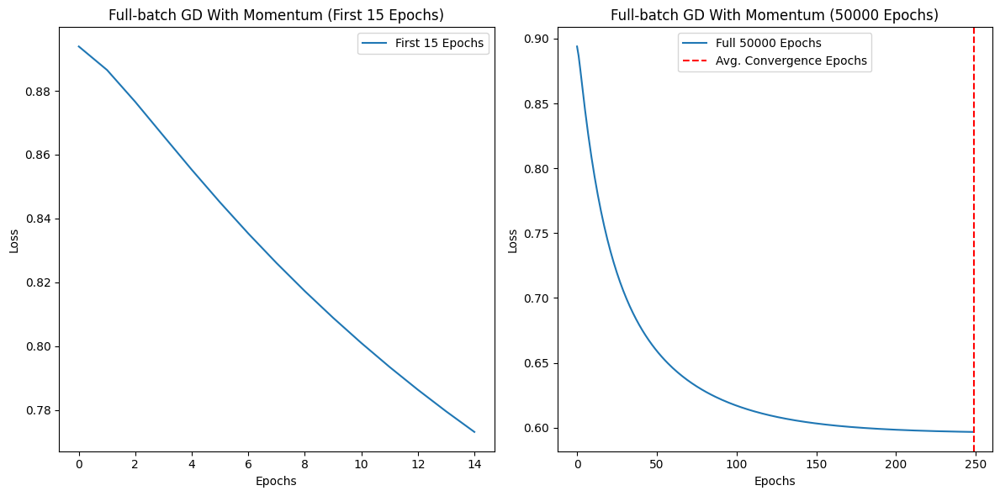

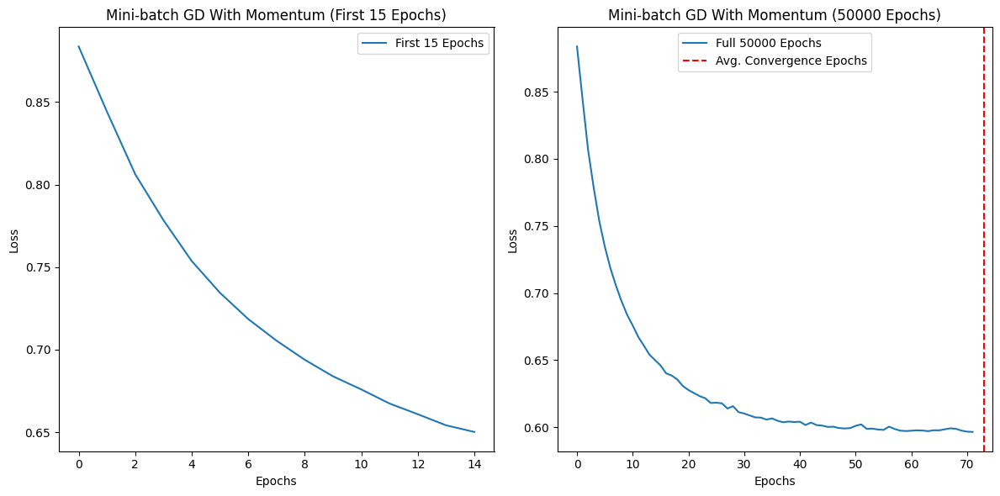

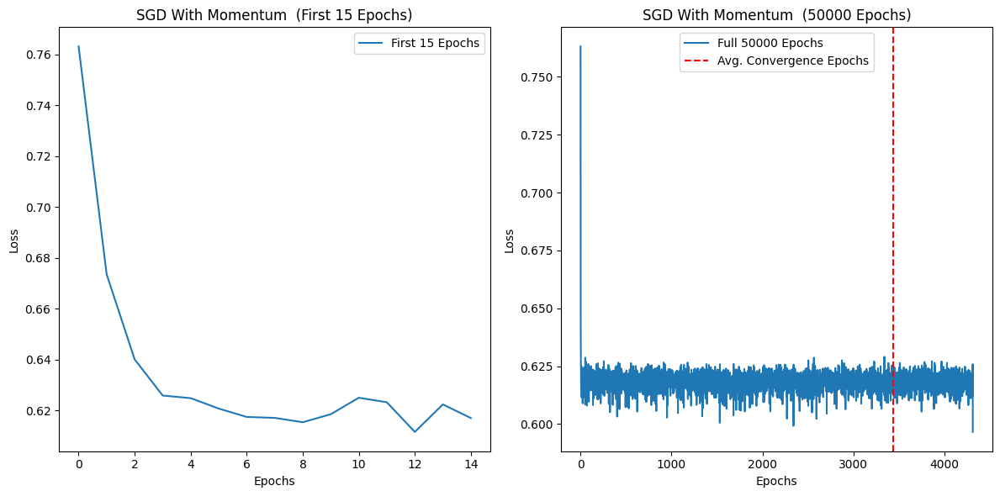

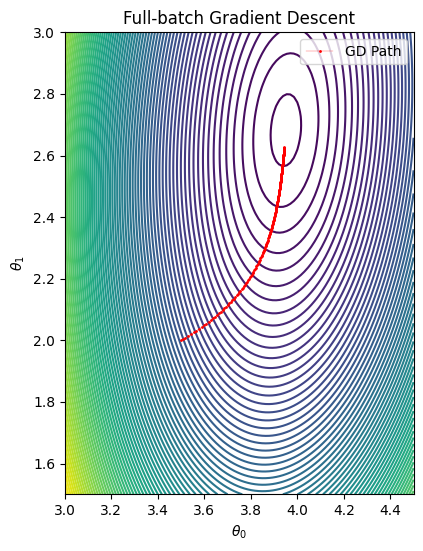

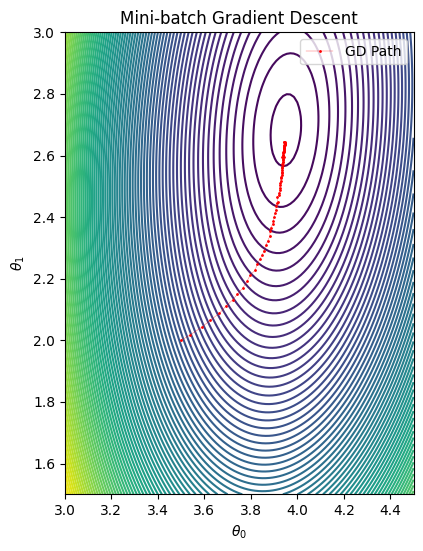

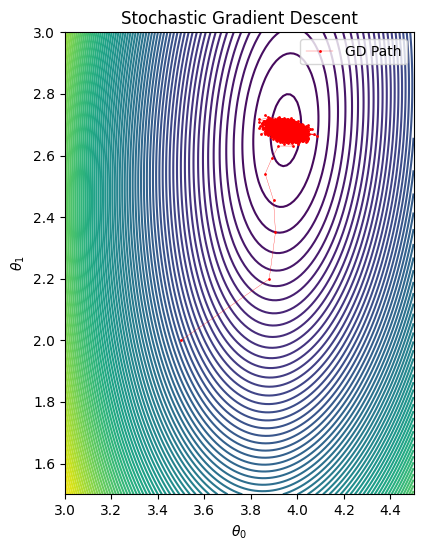

In [5]:

# Gradient Descent Update Step (with momentum)
def update_params_momentum(theta0, theta1, grads, lr, momentum, prev_change_x):
    change_x = lr * grads[0] + momentum * prev_change_x[0]
    theta0.data -= change_x  # out-of-place operation

    change_y = lr * grads[1] + momentum * prev_change_x[1]
    theta1.data -= change_y  # out-of-place operation

    return theta0, theta1, (change_x, change_y)

# Plotting loss over epochs for each method
def plot_loss(losses, title, avg_epochs, max_epochs, filename):
    plt.figure(figsize=(12, 6))

    # Loss for the first 15 epochs
    plt.subplot(1, 2, 1)
    plt.plot(losses[:15], label='First 15 Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'{title} (First 15 Epochs)')
    plt.legend()

    # Loss for the full 50000 epochs
    plt.subplot(1, 2, 2)
    plt.plot(losses, label='Full Epochs')
    plt.axvline(x=avg_epochs, color='r', linestyle='--', label='Avg. Convergence Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'{title} (Full Epochs)')
    plt.legend()

    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

# (based on the closed-form solution or an approximation)
def calculate_optimal_loss(x, y):
    optimal_theta1 = (torch.mean(x * y) - torch.mean(x) * torch.mean(y)) / (torch.mean(x ** 2) - torch.mean(x) ** 2)
    optimal_theta0 = torch.mean(y) - optimal_theta1 * torch.mean(x)
    print(f"Optimal theta0: {optimal_theta0}")
    print(f"Optimal theta1: {optimal_theta1}")
    preds = linear_model(x, optimal_theta0, optimal_theta1)
    optimal_loss = compute_loss(preds, y)
    return optimal_loss.item()

# Full-batch Gradient Descent with Momentum
def full_batch_gd_momentum(x, y, theta0, theta1, lr=0.01, epochs=5000, epsilon=0.001, momentum=0.4, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    prev_change_x = (0.0, 0.0)
    for epoch in range(epochs):
        preds = linear_model(x, theta0, theta1)
        loss = compute_loss(preds, y)
        losses.append(loss.item())

        loss.backward()
        grads = [theta0.grad, theta1.grad]
        theta0, theta1, prev_change_x = update_params_momentum(theta0, theta1, grads, lr, momentum, prev_change_x)
        theta0.grad.zero_()
        theta1.grad.zero_()

        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())

        iterations += 1
        if abs(loss.item() - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1, theta0_path, theta1_path

# Mini-batch Gradient Descent with Momentum
def mini_batch_gd_momentum(x, y, theta0, theta1, lr=0.01, epochs=5000, batch_size=10, epsilon=0.001, momentum=0.4, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    prev_change_x = (0.0, 0.0)
    dataset = torch.utils.data.TensorDataset(x, y)
    loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

    for epoch in range(epochs):
        epoch_loss = 0
        for batch_x, batch_y in loader:
            preds = linear_model(batch_x, theta0, theta1)
            loss = compute_loss(preds, batch_y)
            epoch_loss += loss.item()

            loss.backward()
            grads = [theta0.grad, theta1.grad]
            theta0, theta1, prev_change_x = update_params_momentum(theta0, theta1, grads, lr, momentum, prev_change_x)
            theta0.grad.zero_()
            theta1.grad.zero_()
            iterations += 1
        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())



        avg_loss = epoch_loss / len(loader)
        losses.append(avg_loss)
        if abs(avg_loss - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1, theta0_path, theta1_path

# Stochastic Gradient Descent with Momentum
def sgd_momentum(x, y, theta0, theta1, lr=0.01, epochs=5000, epsilon=0.001, momentum=0.4, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    prev_change_x = (0.0, 0.0)
    dataset = torch.utils.data.TensorDataset(x, y)
    loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=True)

    for epoch in range(epochs):
        epoch_loss = 0
        for point_x, point_y in loader:
            preds = linear_model(point_x, theta0, theta1)
            loss = compute_loss(preds, point_y)
            epoch_loss += loss.item()

            loss.backward()
            grads = [theta0.grad, theta1.grad]
            theta0, theta1, prev_change_x = update_params_momentum(theta0, theta1, grads, lr, momentum, prev_change_x)
            theta0.grad.zero_()
            theta1.grad.zero_()
            iterations += 1
        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())



        avg_loss = epoch_loss / len(loader)
        losses.append(avg_loss)
        if abs(avg_loss - optimal_loss) < epsilon:
            break
    return theta0, theta1, losses, iterations, epoch + 1, theta0_path, theta1_path

# Function to create contour plot
def plot_contour(x, y, theta0_path, theta1_path, title):
    # Define theta0 and theta1 grid
    theta0_vals = np.linspace(3, 4.5, 100)
    theta1_vals = np.linspace(1.5, 3, 100)
    theta0_grid, theta1_grid = np.meshgrid(theta0_vals, theta1_vals)

    # Compute loss for each combination of theta0 and theta1
    loss_grid = np.zeros_like(theta0_grid)
    for i in range(theta0_grid.shape[0]):
        for j in range(theta0_grid.shape[1]):
            preds = theta1_grid[i, j] * x + theta0_grid[i, j]
            loss_grid[i, j] = np.mean((y - preds) ** 2)

    # Plot contour
    plt.figure(figsize=(4.5, 6))
    plt.contour(theta0_grid, theta1_grid, loss_grid, levels=100, cmap='viridis')
    plt.plot(theta0_path, theta1_path, marker='o', markersize=1, linewidth=0.2, color='red', label='GD Path')
    plt.title(title)
    plt.xlabel(r'$\theta_0$')
    plt.ylabel(r'$\theta_1$')
    plt.legend()
    plt.show()

# Initialization and parameters
theta0_init = torch.tensor([3.5], dtype=torch.float32, requires_grad=True)
theta1_init = torch.tensor([2], dtype=torch.float32, requires_grad=True)

# Compute the optimal loss
optimal_loss = calculate_optimal_loss(x1_tensor, y_tensor)
print(f"Optimal loss: {optimal_loss}")

# Run each method multiple times to calculate average iterations and epochs to convergence
num_runs = 10
full_batch_iterations = []
mini_batch_iterations = []
sgd_iterations_list = []
full_batch_epochs = []
mini_batch_epochs = []
sgd_epochs_list = []


for _ in range(num_runs):
    theta0_full, theta1_full, full_losses, full_iterations, full_epochs,full_theta0_path, full_theta1_path = full_batch_gd_momentum(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )
    theta0_mini, theta1_mini, mini_losses, mini_iterations, mini_epochs , mini_theta0_path, mini_theta1_path= mini_batch_gd_momentum(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )
    theta0_sgd, theta1_sgd, sgd_losses, sgd_iterations, sgd_epochs , sgd_theta0_path, sgd_theta1_path = sgd_momentum(
        x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
        theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
    )

    full_batch_iterations.append(full_iterations)
    mini_batch_iterations.append(mini_iterations)
    sgd_iterations_list.append(sgd_iterations)

    full_batch_epochs.append(full_epochs)
    mini_batch_epochs.append(mini_epochs)
    sgd_epochs_list.append(sgd_epochs)

# Calculate average number of iterations and epochs
avg_full_batch_iterations = np.mean(full_batch_iterations)
avg_mini_batch_iterations = np.mean(mini_batch_iterations)
avg_sgd_iterations = np.mean(sgd_iterations_list)

avg_full_batch_epochs = np.mean(full_batch_epochs)
avg_mini_batch_epochs = np.mean(mini_batch_epochs)
avg_sgd_epochs = np.mean(sgd_epochs_list)

# Print the average number of iterations and epochs for each method
print(f"With Momentum : Average Full-batch GD converged in {avg_full_batch_iterations:.2f} iterations and {avg_full_batch_epochs:.2f} epochs")
print(f"With Momentum : Average Mini-batch GD converged in {avg_mini_batch_iterations:.2f} iterations and {avg_mini_batch_epochs:.2f} epochs")
print(f"With Momentum : Average SGD converged in {avg_sgd_iterations:.2f} iterations and {avg_sgd_epochs:.2f} epochs")

# Plotting the losses for comparison (visualizing for 15 and 50000 epochs)
plot_loss(full_losses, "Full-batch GD With Momentum", avg_full_batch_epochs, 5000, 'full_batch_gd_m.png')
plot_loss(mini_losses, "Mini-batch GD With Momentum", avg_mini_batch_epochs, 5000, 'mini_batch_gd_m.png')
plot_loss(sgd_losses, "SGD With Momentum ", avg_sgd_epochs, 5000, 'sgd_m.png')

# Plot the contour plots for each method
plot_contour(x1, y, full_theta0_path, full_theta1_path, "Full-batch Gradient Descent")
plot_contour(x1, y, mini_theta0_path, mini_theta1_path, "Mini-batch Gradient Descent")
plot_contour(x1, y, sgd_theta0_path, sgd_theta1_path, "Stochastic Gradient Descent")


## momentum

Optimal theta0: 3.9507062435150146
Optimal theta1: 2.682468891143799
Optimal loss: 0.5957542061805725


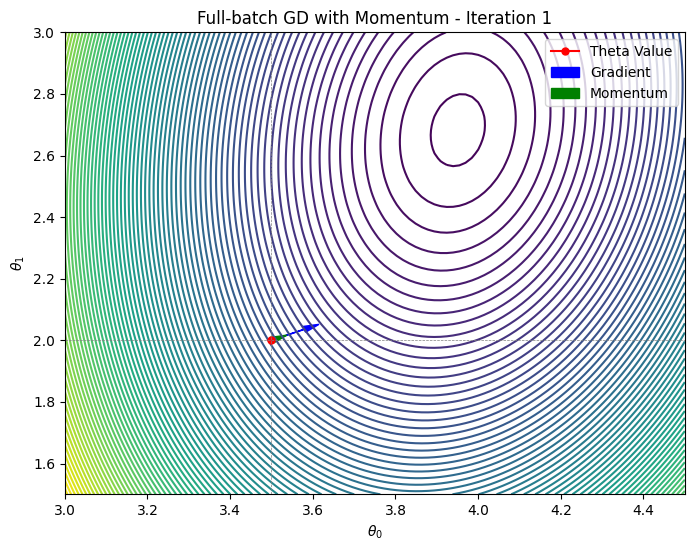

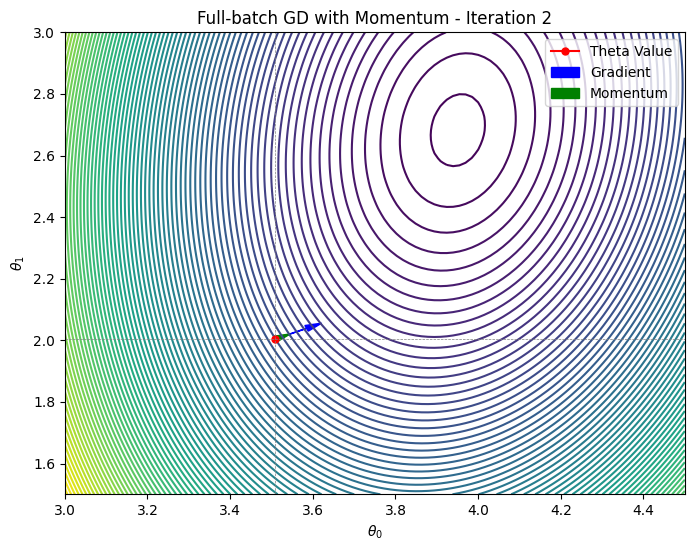

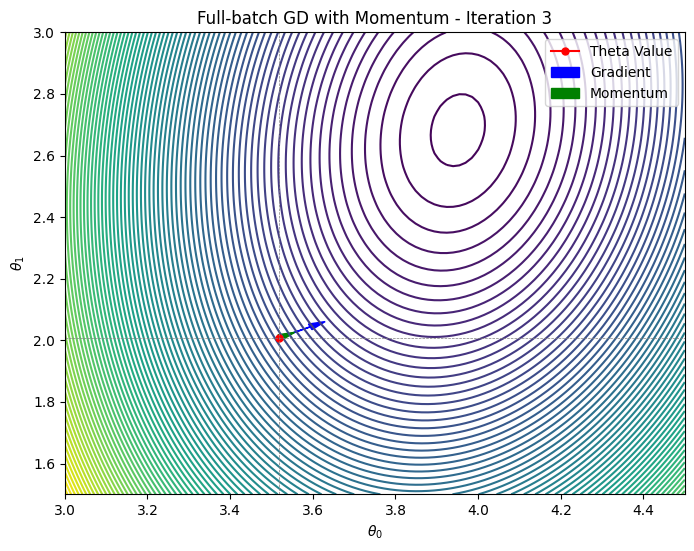

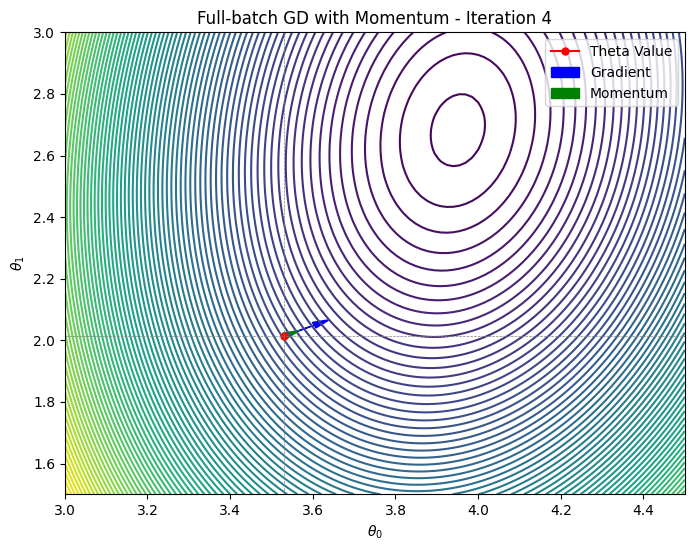

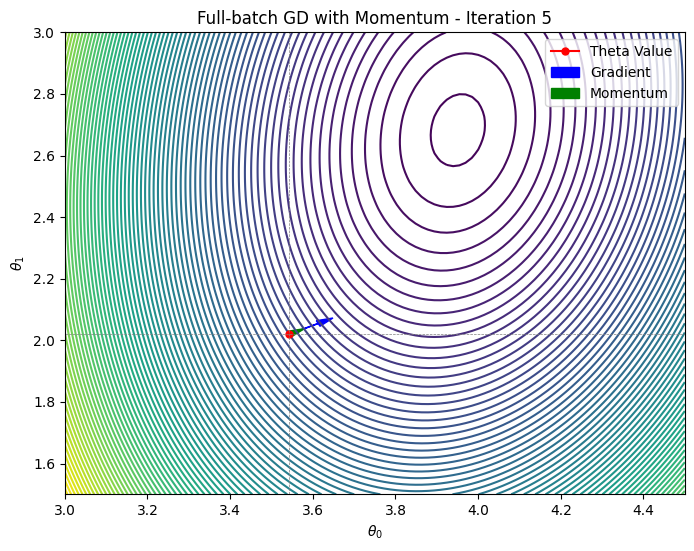

...

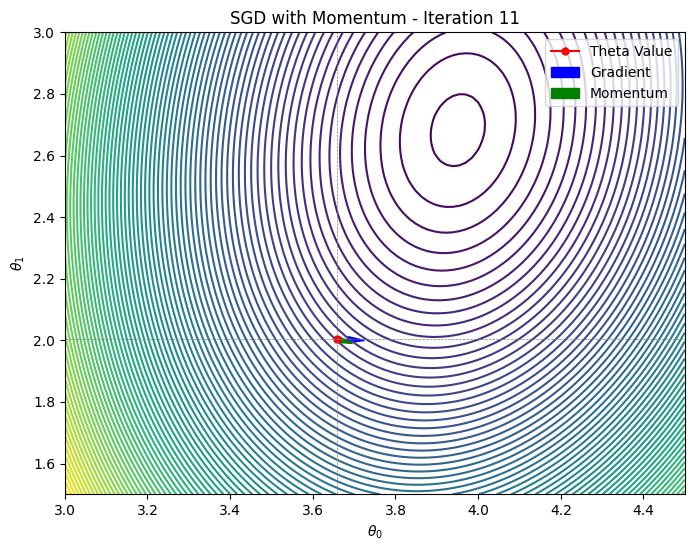

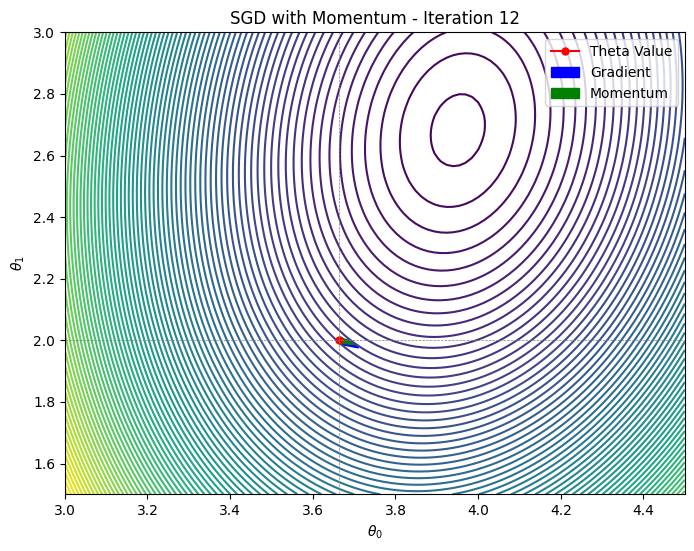

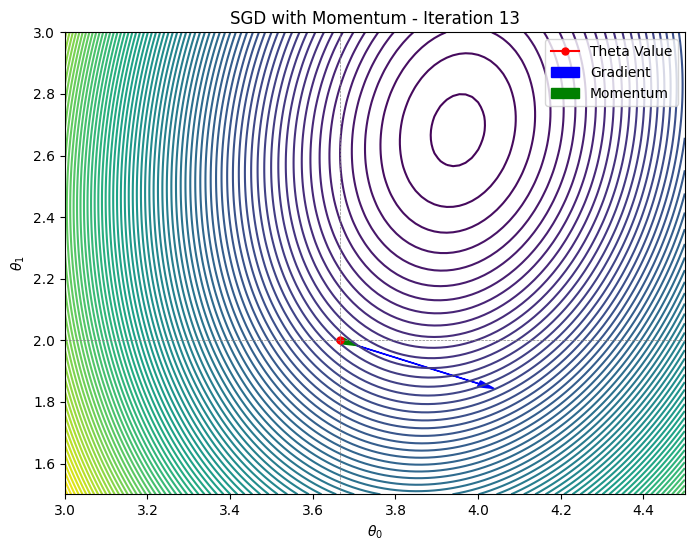

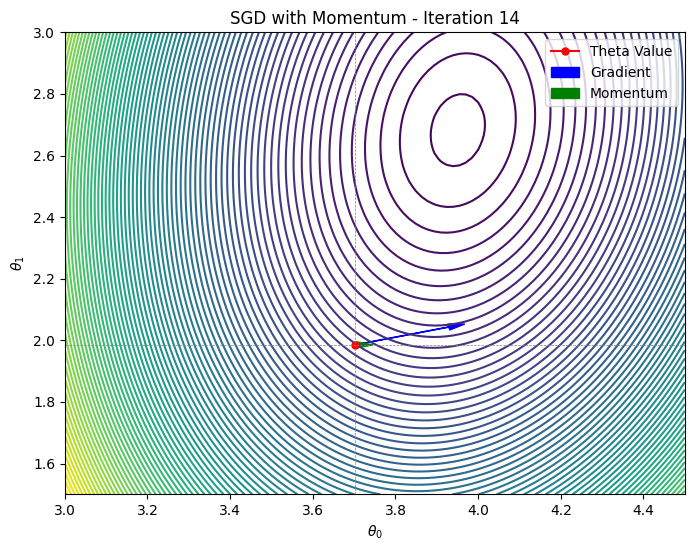

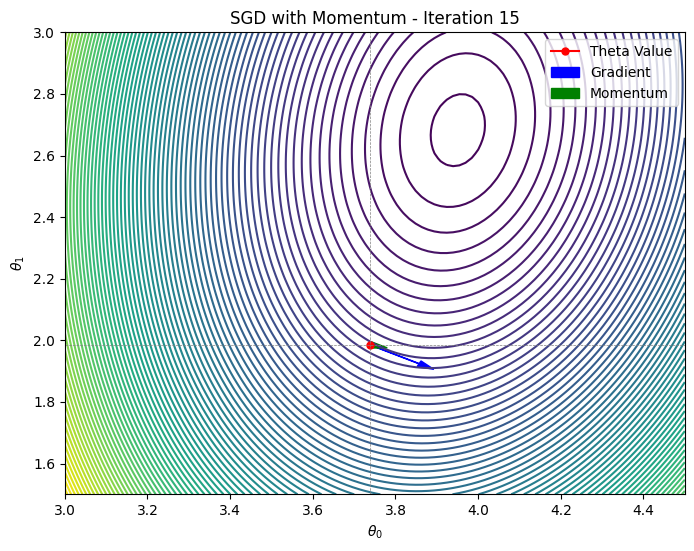

In [16]:

def update_params_momentum(theta0, theta1, grads, lr, momentum, prev_change_x):
    # Update the momentum vectors
    change_x0 = momentum * prev_change_x[0] - lr * grads[0]
    change_x1 = momentum * prev_change_x[1] - lr * grads[1]
    
    # Update parameters
    theta0 = theta0 + change_x0
    theta1 = theta1 + change_x1
    
    return theta0, theta1, (change_x0, change_x1)


def plot_contour_single_iteration(x, y, theta0_path, theta1_path, grad_path, momentum_path, title_prefix):
    # Define theta0 and theta1 grid
    theta0_vals = np.linspace(3, 4.5, 100)
    theta1_vals = np.linspace(1.5, 3, 100)
    theta0_grid, theta1_grid = np.meshgrid(theta0_vals, theta1_vals)

    # Compute loss for each combination of theta0 and theta1
    loss_grid = np.zeros_like(theta0_grid)
    for i in range(theta0_grid.shape[0]):
        for j in range(theta0_grid.shape[1]):
            preds = theta1_grid[i, j] * x + theta0_grid[i, j]
            loss_grid[i, j] = np.mean((y - preds) ** 2)

    # Create a plot for each iteration
    for i in range(15):
        plt.figure(figsize=(8, 6))
        plt.contour(theta0_grid, theta1_grid, loss_grid, levels=100, cmap='viridis')

        # Plot the current theta value
        theta0, theta1 = theta0_path[i], theta1_path[i]
        plt.plot(theta0, theta1, marker='o', markersize=5, color='red', label='Theta Value')

        # Add lines parallel to x-axis and y-axis at each point
        plt.axhline(y=theta1, color='gray', linestyle='--', linewidth=0.5)  # Horizontal line (parallel to x-axis)
        plt.axvline(x=theta0, color='gray', linestyle='--', linewidth=0.5)  # Vertical line (parallel to y-axis)

        # Gradient vector (blue)
        grad_theta0, grad_theta1 = grad_path[i]
        plt.arrow(theta0, theta1, -grad_theta0 * 0.1, -grad_theta1 * 0.1, 
                  head_width=0.02, head_length=0.04, fc='blue', ec='blue', label='Gradient')

        # Momentum vector (green)
        mom_theta0, mom_theta1 = momentum_path[i]
        plt.arrow(theta0, theta1, mom_theta0 * 0.1, mom_theta1 * 0.1, 
                  head_width=0.02, head_length=0.04, fc='green', ec='green', label='Momentum')

        # Plot settings
        plt.title(f"{title_prefix} - Iteration {i + 1}")
        plt.xlabel(r'$\theta_0$')
        plt.ylabel(r'$\theta_1$')
        plt.legend()
        plt.show()


# Full-batch Gradient Descent with Momentum 
def full_batch_gd_momentum(x, y, theta0, theta1, lr=0.01, epochs=5000, epsilon=0.001, momentum=0.4, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    grad_path, momentum_path = [], []
    prev_change_x = (0.0, 0.0)

    for epoch in range(epochs):
        preds = linear_model(x, theta0, theta1)
        loss = compute_loss(preds, y)
        losses.append(loss.item())

        # Compute gradients
        loss.backward()

        # Store gradients
        grads = [theta0.grad.item(), theta1.grad.item()]

        # Update parameters
        theta0, theta1, prev_change_x = update_params_momentum(
            theta0.clone().detach().requires_grad_(True), 
            theta1.clone().detach().requires_grad_(True),
            [torch.tensor(grads[0]), torch.tensor(grads[1])], lr, momentum, prev_change_x
        )
        
        # Retain gradients for next iteration
        theta0.retain_grad()
        theta1.retain_grad()

        # Store paths and grads
        theta0_path.append(theta0.item())
        theta1_path.append(theta1.item())
        grad_path.append(grads)
        momentum_path.append(prev_change_x)

        iterations += 1
        if abs(loss.item() - optimal_loss) < epsilon:
            break

    return theta0, theta1, losses, iterations, epoch + 1, theta0_path, theta1_path, grad_path, momentum_path



def sgd_momentum(x, y, theta0, theta1, lr=0.01, epochs=5000, epsilon=0.001, momentum=0.4, optimal_loss=None):
    losses = []
    iterations = 0
    theta0_path, theta1_path = [theta0.item()], [theta1.item()]
    grad_path = []  # Initialize empty list for gradients
    momentum_path = []  # Initialize empty list for momentum vectors
    prev_change_x = (0.0, 0.0)
    dataset = torch.utils.data.TensorDataset(x, y)
    loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=True)

    for epoch in range(epochs):
        epoch_loss = 0
        for point_x, point_y in loader:
            # Make predictions
            preds = linear_model(point_x, theta0, theta1)
            loss = compute_loss(preds, point_y)
            epoch_loss += loss.item()

            # Compute gradients
            loss.backward()

            # Store gradients
            grads = [theta0.grad.item(), theta1.grad.item()]

            # Update parameters with momentum
            theta0, theta1, prev_change_x = update_params_momentum(
                theta0.clone().detach().requires_grad_(True), 
                theta1.clone().detach().requires_grad_(True),
                [torch.tensor(grads[0]), torch.tensor(grads[1])], lr, momentum, prev_change_x
            )

            # Retain gradients for next iteration
            theta0.retain_grad()
            theta1.retain_grad()

            # Store paths and grads
            theta0_path.append(theta0.item())
            theta1_path.append(theta1.item())
            grad_path.append(grads)
            momentum_path.append(prev_change_x)

            iterations += 1

        # Calculate average loss for the epoch
        avg_loss = epoch_loss / len(loader)
        losses.append(avg_loss)

        if abs(avg_loss - optimal_loss) < epsilon:
            break

    return theta0, theta1, losses, iterations, epoch + 1, theta0_path, theta1_path, grad_path, momentum_path


# Initialization and parameters
theta0_init = torch.tensor([3.5], dtype=torch.float32, requires_grad=True)
theta1_init = torch.tensor([2], dtype=torch.float32, requires_grad=True)

# Compute the optimal loss
optimal_loss = calculate_optimal_loss(x1_tensor, y_tensor)
print(f"Optimal loss: {optimal_loss}")



# Full-batch GD with Momentum
theta0_full, theta1_full, full_losses, full_iterations, full_epochs, full_theta0_path, full_theta1_path, full_grad_path, full_momentum_path = full_batch_gd_momentum(
    x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
    theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
)
# Plot for Full-batch GD with Momentum
plot_contour_single_iteration(x1, y, full_theta0_path, full_theta1_path, full_grad_path, full_momentum_path, "Full-batch GD with Momentum")


# SGD with Momentum
theta0_sgd, theta1_sgd, sgd_losses, sgd_iterations, sgd_epochs, sgd_theta0_path, sgd_theta1_path, sgd_grad_path, sgd_momentum_path = sgd_momentum(
    x1_tensor, y_tensor, theta0_init.clone().detach().requires_grad_(True),
    theta1_init.clone().detach().requires_grad_(True), optimal_loss=optimal_loss
)
# Plot for SGD with Momentum
plot_contour_single_iteration(x1, y, sgd_theta0_path, sgd_theta1_path, sgd_grad_path, sgd_momentum_path, "SGD with Momentum")

